In [15]:
import os
import numpy as np
import matplotlib.pyplot as plt
from skimage import io, color

# SPATIAL FREQUENCY

## Base Code

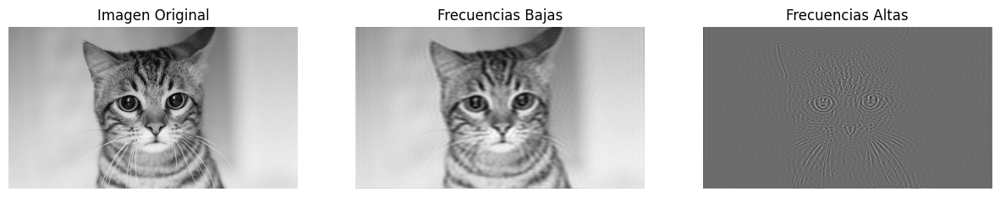

In [2]:

image = io.imread('gato.jpg')

gray_image = color.rgb2gray(image)

# Aplicar la transformada rápida de Fourier
f_transform = np.fft.fft2(gray_image)
f_transform_shifted = np.fft.fftshift(f_transform)

# Crear un filtro de paso bajo (frecuencias bajas)
rows, cols = gray_image.shape
crow, ccol = rows // 2, cols // 2
low_pass_filter = np.zeros((rows, cols))
radius = 50
y, x = np.ogrid[:rows, :cols]
mask = (x - ccol)**2 + (y - crow)**2 <= radius**2
low_pass_filter[mask] = 1

# Crear un filtro de paso alto (frecuencias altas)
high_pass_filter = 1 - low_pass_filter

# Aplicar los filtros
low_frequencies = f_transform_shifted * low_pass_filter
high_frequencies = f_transform_shifted * high_pass_filter

# Transformar de vuelta al dominio espacial
low_image = np.fft.ifft2(np.fft.ifftshift(low_frequencies))
high_image = np.fft.ifft2(np.fft.ifftshift(high_frequencies))

# Tomar la parte real de las imágenes
low_image = np.real(low_image)
high_image = np.real(high_image)

# Mostrar las imágenes
fig, ax = plt.subplots(1, 3, figsize=(15, 5))
ax[0].imshow(gray_image, cmap='gray')
ax[0].set_title('Imagen Original')
ax[1].imshow(low_image, cmap='gray')
ax[1].set_title('Frecuencias Bajas')
ax[2].imshow(high_image, cmap='gray')
ax[2].set_title('Frecuencias Altas')
for a in ax:
    a.axis('off')
plt.show()


## EXTRACCIÓN DE FRECUENCIAS ESPACIALES SECUENCIAL (SKIMAGE)

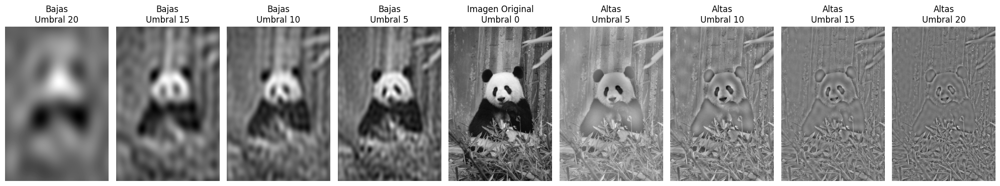

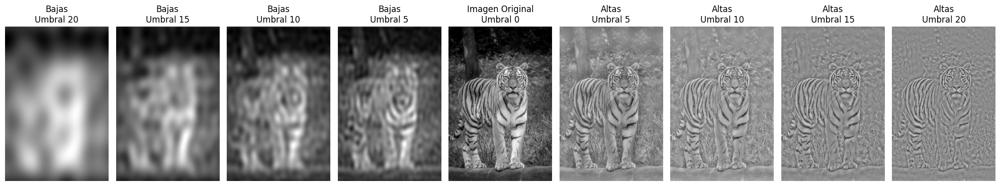

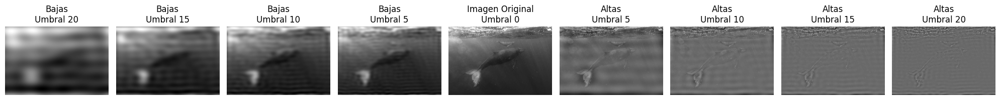

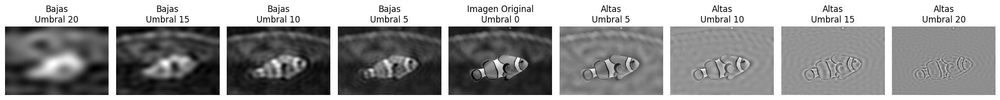

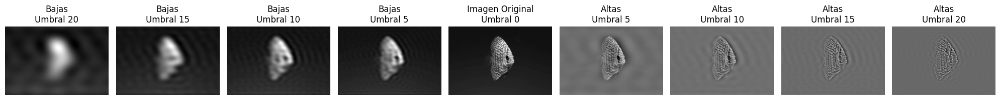

...

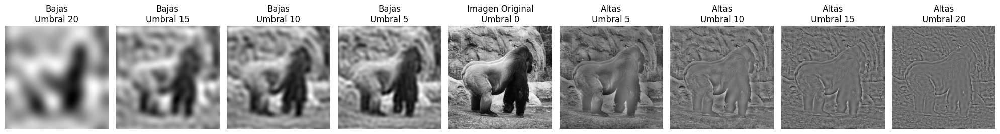

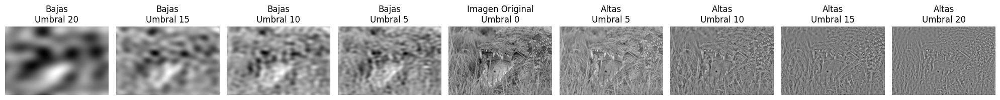

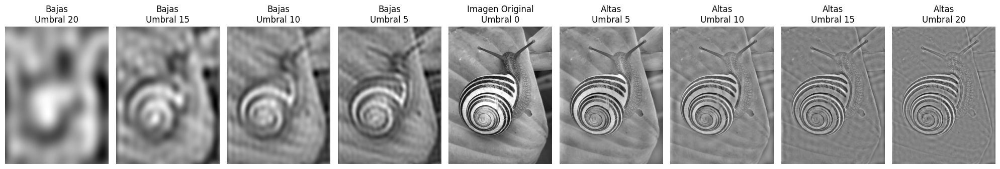

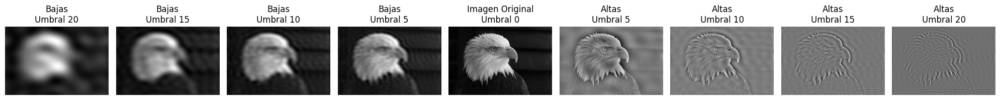

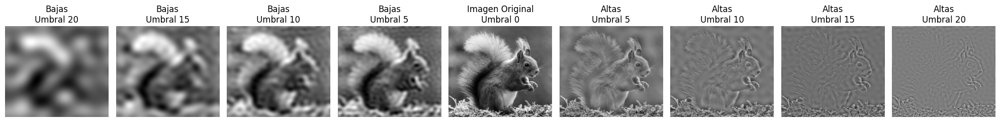

In [20]:
import os
import numpy as np
import matplotlib.pyplot as plt
from skimage import io, color

input_dir = 'input_images'
output_dir = 'output_images'

# Crear el directorio de salida si no existe
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Obtener la lista de archivos de imagen en el directorio de entrada
image_files = [f for f in os.listdir(input_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]

# Crear umbrales
thresholds = [5, 10, 15, 20]

for image_file in image_files:
    # Cargar la imagen
    image_path = os.path.join(input_dir, image_file)
    image = io.imread(image_path)
    gray_image = color.rgb2gray(image)

    # Aplicar la transformada rápida de Fourier
    f_transform = np.fft.fft2(gray_image)
    f_transform_shifted = np.fft.fftshift(f_transform)

    # Inicializar listas para almacenar las imágenes de baja y alta frecuencia
    low_images = []
    high_images = []

    # Crear imágenes de baja y alta frecuencia para cada umbral
    for radius in thresholds:
        # Crear un filtro de paso bajo (frecuencias bajas)
        rows, cols = gray_image.shape
        crow, ccol = rows // 2, cols // 2
        low_pass_filter = np.zeros((rows, cols))
        y, x = np.ogrid[:rows, :cols]
        mask = (x - ccol)**2 + (y - crow)**2 <= radius**2
        low_pass_filter[mask] = 1

        # Crear un filtro de paso alto (frecuencias altas)
        high_pass_filter = 1 - low_pass_filter

        # Aplicar los filtros
        low_frequencies = f_transform_shifted * low_pass_filter
        high_frequencies = f_transform_shifted * high_pass_filter

        # Transformar de vuelta al dominio espacial
        low_image = np.fft.ifft2(np.fft.ifftshift(low_frequencies))
        high_image = np.fft.ifft2(np.fft.ifftshift(high_frequencies))

        # Tomar la parte real de las imágenes
        low_images.append(np.real(low_image))
        high_images.append(np.real(high_image))

    # Preparar las imágenes para visualización
    total_images = len(low_images) + len(high_images) + 1
    center_index = len(low_images) // 2
    images = low_images + [gray_image]  + high_images
    titles = [f'Bajas\nUmbral {t}' for t in thresholds[::-1]] + ['Imagen Original\nUmbral 0'] + [f'Altas\nUmbral {t}' for t in thresholds]

    # Mostrar las imágenes en una sola fila y guardarlas
    fig, ax = plt.subplots(1, len(images), figsize=(20, 5))
    for i, (image, title) in enumerate(zip(images, titles)):
        ax[i].imshow(image, cmap='gray')
        ax[i].set_title(title)
        ax[i].axis('off')

    plt.tight_layout()

    # Guardar la figura
    output_path = os.path.join(output_dir, f'frecuencias_{image_file}')
    plt.savefig(output_path)
    plt.show()


# SATURATION (OPENCV)

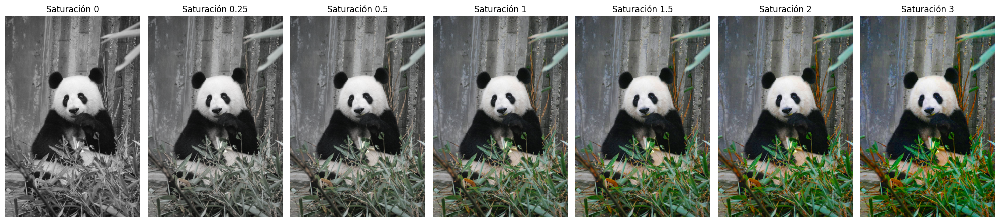

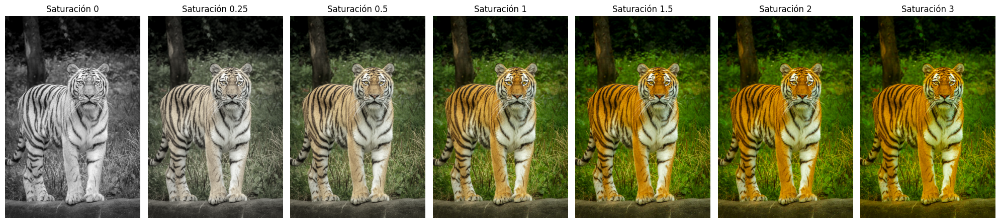

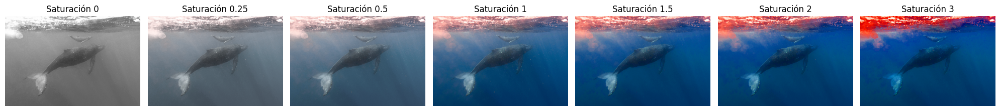

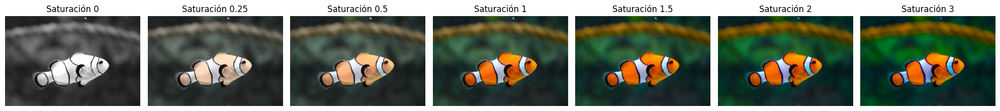

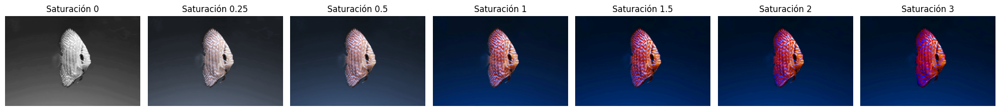

...

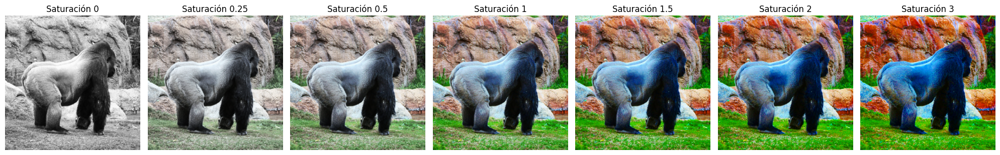

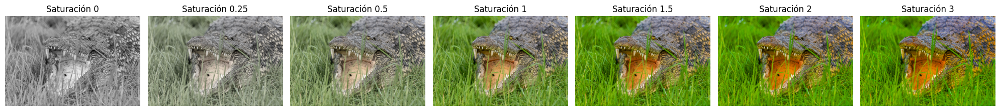

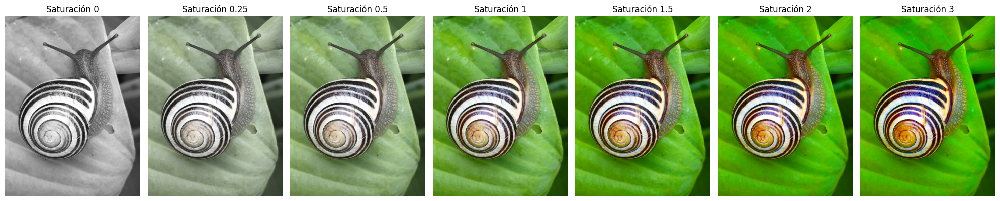

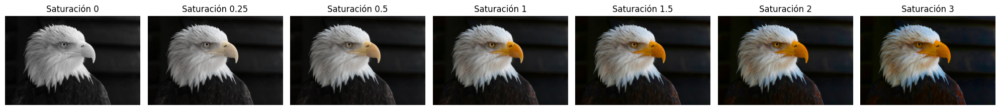

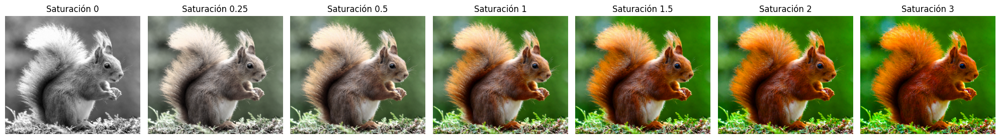

In [18]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

input_dir = 'input_images'
output_dir = 'output_images'

# Crear el directorio de salida si no existe
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Obtener la lista de archivos de imagen en el directorio de entrada
image_files = [f for f in os.listdir(input_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]

# Crear diferentes niveles de saturación
saturations = [0, 0.25, 0.5, 1, 1.5, 2, 3]

for image_file in image_files:
    # Cargar la imagen
    image_path = os.path.join(input_dir, image_file)
    image = cv2.imread(image_path)

    # Convertir la imagen de BGR a HSV
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    
    # Inicializar lista para almacenar las imágenes con diferentes saturaciones
    saturation_images = []

    # Aplicar diferentes niveles de saturación
    for saturation in saturations:
        hsv_adjusted = hsv_image.copy()
        hsv_adjusted[..., 1] = cv2.multiply(hsv_adjusted[..., 1], saturation)
        adjusted_image = cv2.cvtColor(hsv_adjusted, cv2.COLOR_HSV2BGR)
        saturation_images.append(adjusted_image)

    # Preparar las imágenes para visualización
    total_images = len(saturation_images)
    images = saturation_images
    titles = [f'Saturación {saturation}' for saturation in saturations]

    # Mostrar las imágenes en una sola fila y guardarlas
    fig, ax = plt.subplots(1, total_images, figsize=(20, 5))
    for i, (image, title) in enumerate(zip(images, titles)):
        ax[i].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        ax[i].set_title(title)
        ax[i].axis('off')

    plt.tight_layout()

    # Guardar la figura
    output_path = os.path.join(output_dir, f'saturacion_{image_file}')
    plt.savefig(output_path)
    plt.show()


# CONTRAST

## TÉCNICA 1

Ajuste de contraste lineal


El contraste mide, en cierto modo, el rango dinámico de los colores en la imagen, es decir, una imagen muy contrastada tiene un amplio abanico de colores (o tonos de gris) desde valores muy bajos a valores muy altos. Para una imagen con poco contraste los colores están muy juntos, el margen dinámico es pequeño.

La variación en el contraste aparece como una compresión del histograma en caso de una reducción, o una expansión en caso de aumento de contraste. Al igual que el brillo, variando el contraste se puede provocar una pérdida de información de la imagen.

https://www.uv.es/gpoei/eng/Pfc_web/realzado/contraste/contraste.htm

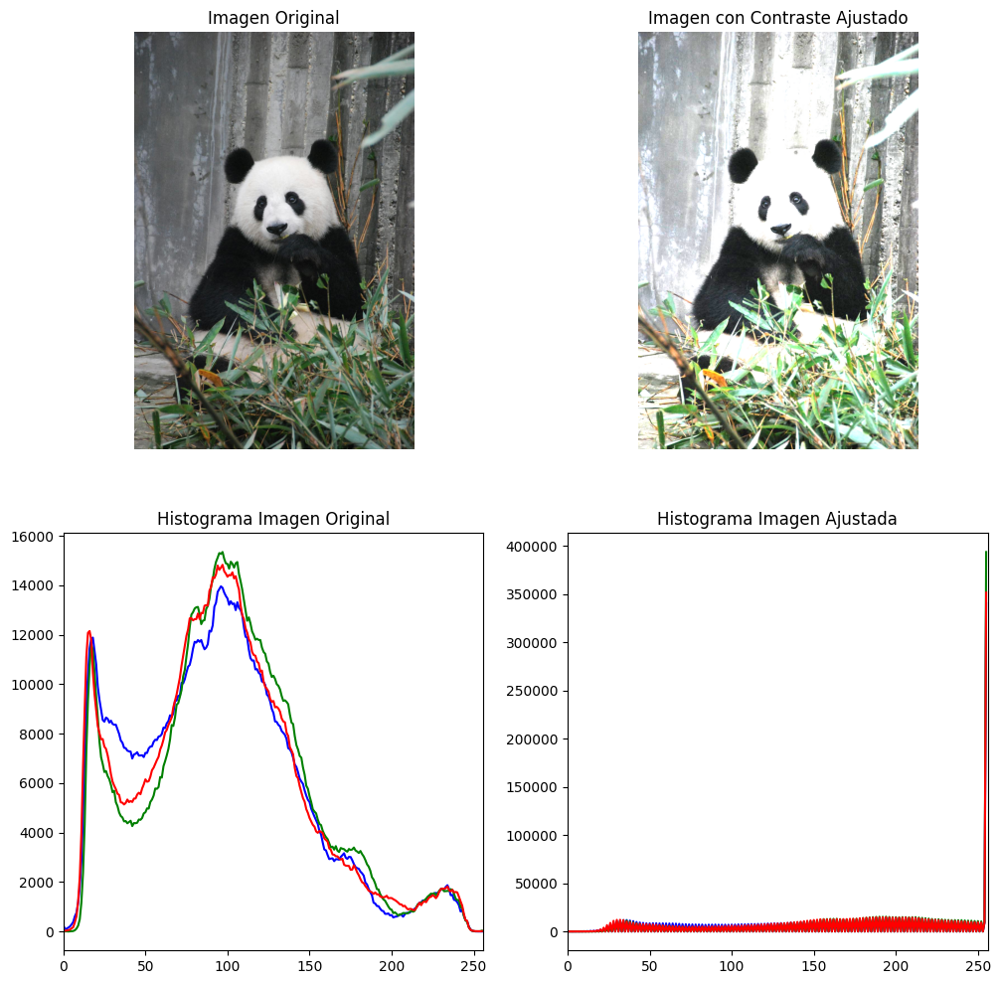

In [1]:
def ajustar_contraste(img, alpha, beta):
    # img: imagen de entrada
    # alpha: factor de ganancia (contraste)
    # beta: valor agregado (brillo)
    adjusted = cv2.convertScaleAbs(img, alpha=alpha, beta=beta)
    return adjusted

def mostrar_histograma(img, title, position):
    color = ('b', 'g', 'r')
    for i, col in enumerate(color):
        hist = cv2.calcHist([img], [i], None, [256], [0, 256])
        plt.subplot(2, 2, position)
        plt.plot(hist, color=col)
        plt.xlim([0, 256])
    plt.title(title)

img = cv2.imread('input_images/panda.jpeg', 1)

alpha = 2  # Factor de ganancia
beta = 0    # Valor de brillo
contrasted_img = ajustar_contraste(img, alpha, beta)

plt.figure(figsize=(12, 12))

plt.subplot(2, 2, 1)
plt.title('Imagen Original')
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(2, 2, 2)
plt.title('Imagen con Contraste Ajustado')
plt.imshow(cv2.cvtColor(contrasted_img, cv2.COLOR_BGR2RGB))
plt.axis('off')

mostrar_histograma(img, 'Histograma Imagen Original', 3)
mostrar_histograma(contrasted_img, 'Histograma Imagen Ajustada', 4)

plt.show()


## TÉCNICA 2: Ajuste del Grado de Contraste a través de Corrección Gamma

Un valor de gamma menor que 1 aumentará el contraste, mientras que un valor mayor que 1 lo disminuirá.

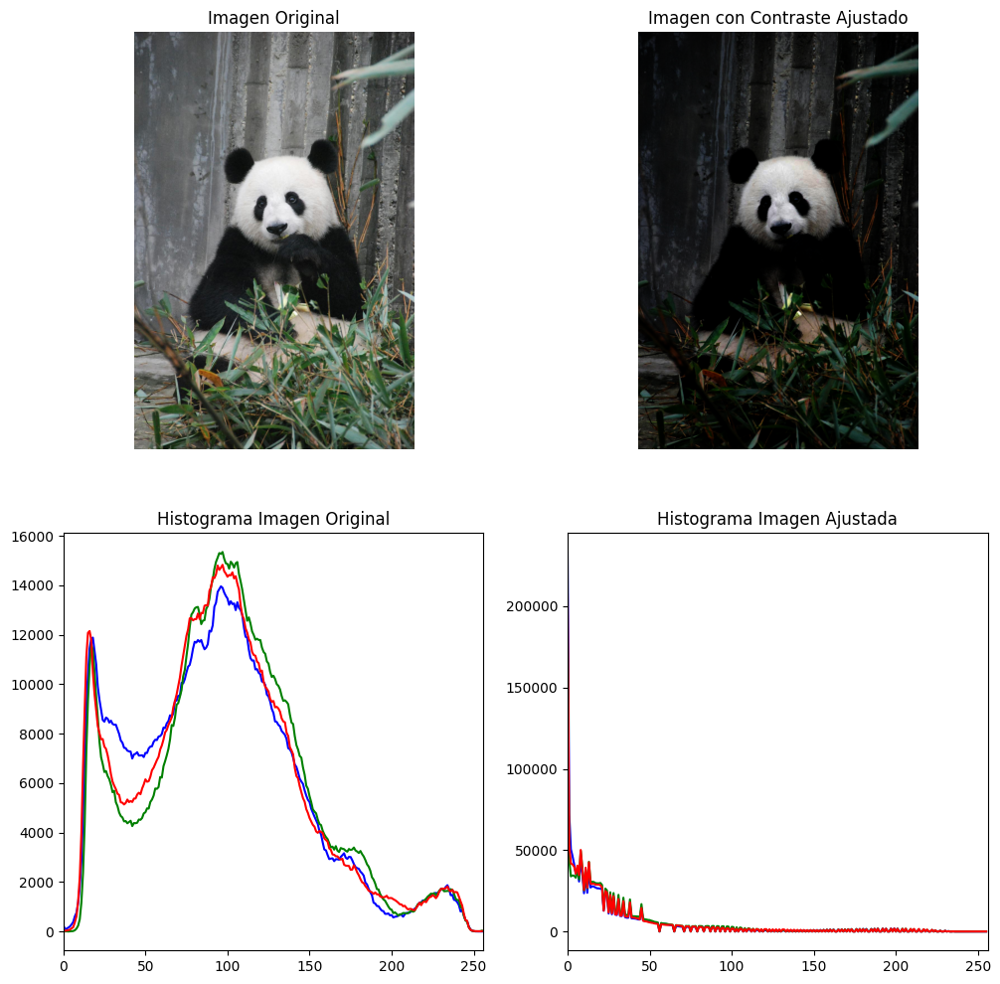

In [22]:
def ajustar_contraste_gamma(img, gamma):
    inv_gamma = 1.0 / gamma
    table = np.array([((i / 255.0) ** inv_gamma) * 255 for i in np.arange(0, 256)]).astype("uint8")
    return cv2.LUT(img, table)

def mostrar_histograma(img, title, position):
    color = ('b', 'g', 'r')
    plt.subplot(2, 2, position)
    for i, col in enumerate(color):
        hist = cv2.calcHist([img], [i], None, [256], [0, 256])
        plt.plot(hist, color=col)
        plt.xlim([0, 256])
    plt.title(title)

img = cv2.imread('input_images/panda.jpeg', 1)

gamma = 0.35 
contrasted_img = ajustar_contraste_gamma(img, gamma)

plt.figure(figsize=(12, 12))

plt.subplot(2, 2, 1)
plt.title('Imagen Original')
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(2, 2, 2)
plt.title('Imagen con Contraste Ajustado')
plt.imshow(cv2.cvtColor(contrasted_img, cv2.COLOR_BGR2RGB))
plt.axis('off')

mostrar_histograma(img, 'Histograma Imagen Original', 3)
mostrar_histograma(contrasted_img, 'Histograma Imagen Ajustada', 4)

plt.show()


## TÉCNICA 3: Ajuste de contraste usando curvas de tono (CLAHE)

Ecualización de Histograma

La ecualización de histograma es una técnica para mejorar el contraste de una imagen. Funciona redistribuyendo los valores de intensidad de la imagen para que el histograma de los niveles de intensidad sea más uniforme. Esto suele hacer que las características importantes de la imagen sean más visibles, especialmente en imágenes con contraste pobre.
CLAHE (Contrast Limited Adaptive Histogram Equalization)

CLAHE es una variante de la ecualización de histograma que se aplica localmente en pequeñas regiones (teselas) de la imagen en lugar de hacerlo globalmente. CLAHE limita el contraste para evitar la amplificación excesiva del ruido en regiones homogéneas.

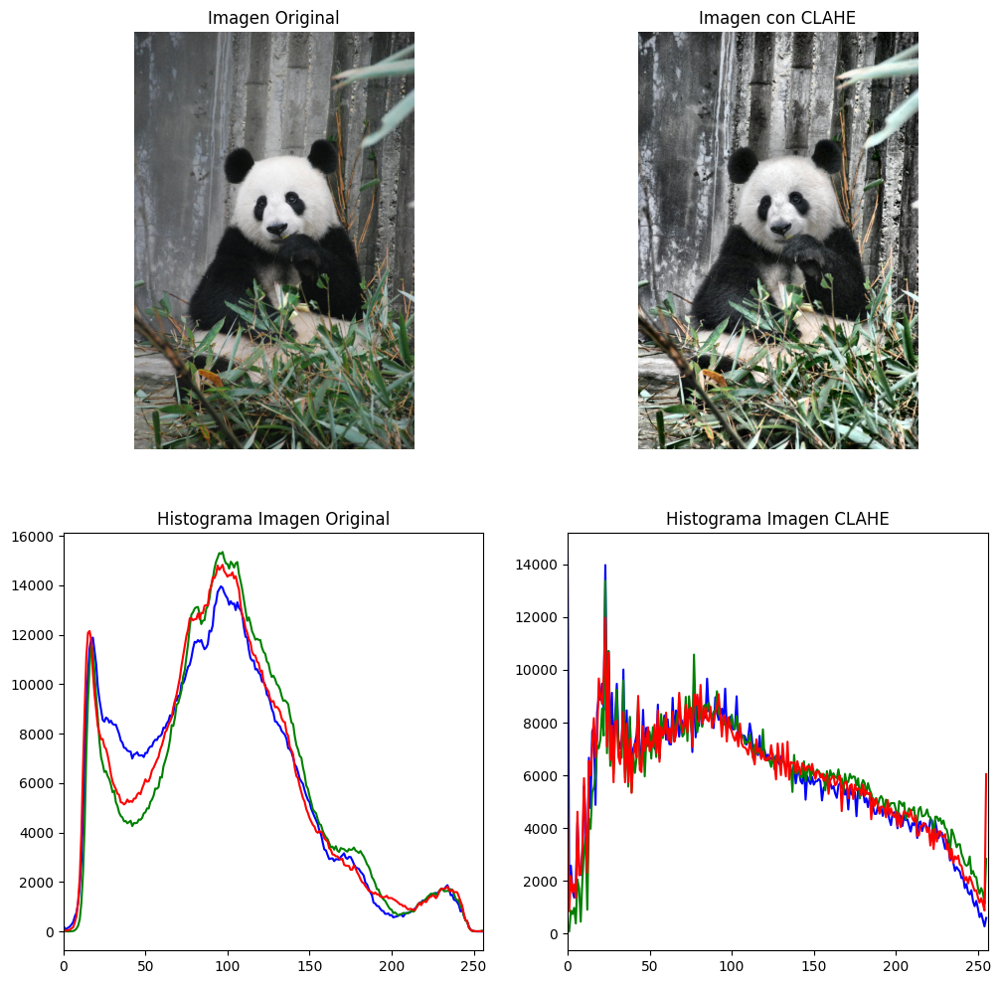

In [24]:
# Función para aplicar CLAHE en el canal de luminancia
def aplicar_clahe(img):
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l_channel, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8,8))
    cl = clahe.apply(l_channel)
    limg = cv2.merge((cl, a, b))
    return cv2.cvtColor(limg, cv2.COLOR_LAB2BGR)

contrasted_img_clahe = aplicar_clahe(img)

plt.figure(figsize=(12, 12))

plt.subplot(2, 2, 1)
plt.title('Imagen Original')
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(2, 2, 2)
plt.title('Imagen con CLAHE')
plt.imshow(cv2.cvtColor(contrasted_img_clahe, cv2.COLOR_BGR2RGB))
plt.axis('off')

mostrar_histograma(img, 'Histograma Imagen Original', 3)
mostrar_histograma(contrasted_img_clahe, 'Histograma Imagen CLAHE', 4)

plt.show()


In [ ]:
input_dir = 'input_images'
output_dir = 'output_images'

if not os.path.exists(output_dir):
    os.makedirs(output_dir)

image_files = [f for f in os.listdir(input_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]

# Crear diferentes niveles de contraste usando CLAHE
clip_limits = [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 8.0]

def aplicar_clahe(img, clip_limit):
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l_channel, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=(8,8))
    cl = clahe.apply(l_channel)
    limg = cv2.merge((cl, a, b))
    return cv2.cvtColor(limg, cv2.COLOR_LAB2BGR)

for image_file in image_files:
    image_path = os.path.join(input_dir, image_file)
    image = cv2.imread(image_path)
    
    contrast_images = []

    # Aplicar diferentes niveles de CLAHE
    for clip_limit in clip_limits:
        adjusted_image = aplicar_clahe(image, clip_limit)
        contrast_images.append(adjusted_image)

    # Preparar las imágenes para visualización
    total_images = len(contrast_images)
    images = contrast_images
    titles = [f'CLAHE {clip_limit}' for clip_limit in clip_limits]

    # Mostrar las imágenes en una sola fila y guardarlas
    fig, ax = plt.subplots(1, total_images, figsize=(20, 5))
    for i, (image, title) in enumerate(zip(images, titles)):
        ax[i].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        ax[i].set_title(title)
        ax[i].axis('off')

    plt.tight_layout()

    output_path = os.path.join(output_dir, f'clahe_{image_file}')
    plt.savefig(output_path)
    plt.show()


## TÉCNICA 4: Transformación/escalado lineal del contraste

Afecta todos los píxeles por igual, sin enfoques adaptativos o específicos para ciertas áreas de la imagen.

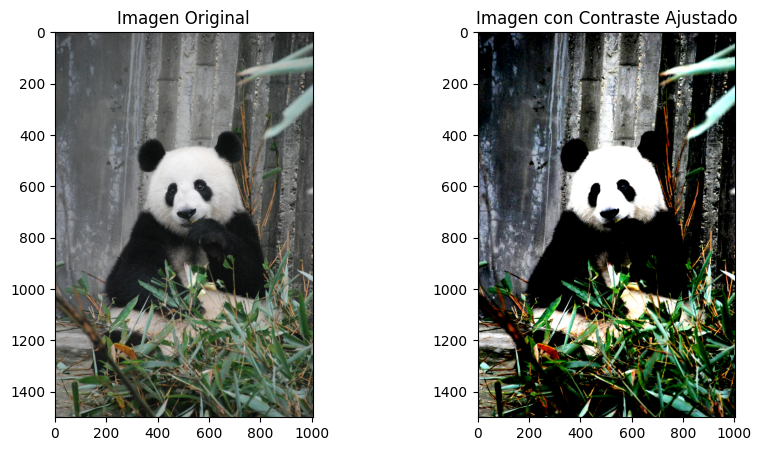

In [13]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def ajustar_contraste(imagen, factor_contraste):
    """
    Ajusta el contraste de la imagen de forma lineal.

    :param imagen: Imagen de entrada en formato numpy array.
    :param factor_contraste: Factor de contraste, puede ser positivo o negativo.
    :return: Imagen con el contraste ajustado.
    """
    
    imagen_float = imagen.astype(np.float32)
    
    # Aplicar la transformación de contraste
    imagen_con_contraste = factor_contraste * (imagen_float - 128) + 128
    
    # Asegurarse de que los valores están en el rango [0, 255]
    imagen_con_contraste = np.clip(imagen_con_contraste, 0, 255)
    
    imagen_con_contraste = imagen_con_contraste.astype(np.uint8)
    
    return imagen_con_contraste

imagen = cv2.imread('input_images/panda.jpeg')

# Ajustar el contraste
factor_contraste = 2.5  # Ejemplos: 0.5 o -1.0
imagen_con_contraste = ajustar_contraste(imagen, factor_contraste)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.title('Imagen Original')
plt.imshow(cv2.cvtColor(imagen, cv2.COLOR_BGR2RGB))

plt.subplot(1, 2, 2)
plt.title('Imagen con Contraste Ajustado')
plt.imshow(cv2.cvtColor(imagen_con_contraste, cv2.COLOR_BGR2RGB))

plt.show()


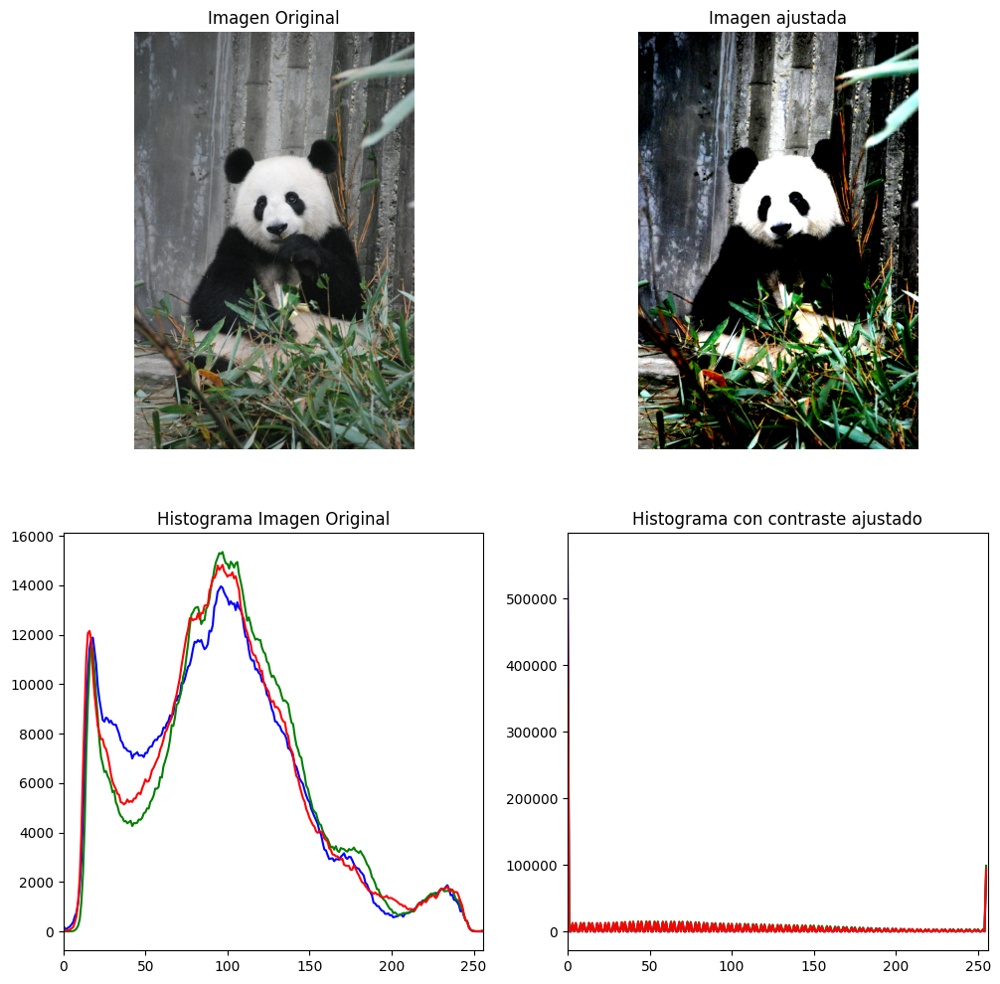

In [14]:
def mostrar_histograma(img, title, position):
    color = ('b', 'g', 'r')
    plt.subplot(2, 2, position)
    for i, col in enumerate(color):
        hist = cv2.calcHist([img], [i], None, [256], [0, 256])
        plt.plot(hist, color=col)
        plt.xlim([0, 256])
    plt.title(title)


plt.figure(figsize=(12, 12))

plt.subplot(2, 2, 1)
plt.title('Imagen Original')
plt.imshow(cv2.cvtColor(imagen, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(2, 2, 2)
plt.title('Imagen ajustada')
plt.imshow(cv2.cvtColor(imagen_con_contraste, cv2.COLOR_BGR2RGB))
plt.axis('off')

# Mostrar histogramas
mostrar_histograma(imagen, 'Histograma Imagen Original', 3)
mostrar_histograma(imagen_con_contraste, 'Histograma con contraste ajustado', 4)

plt.show()